In [ ]:
%pip install pydicom SimpleITK matplotlib numpy


Defaulting to user installation because normal site-packages is not writeable
Note: you may need to restart the kernel to use updated packages.


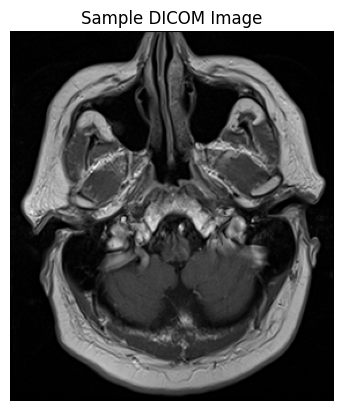

In [11]:
import pydicom
import matplotlib.pyplot as plt

data_file = "1-02.dcm"  
dicom_file = pydicom.dcmread(data_file)

sample_image = dicom_file.pixel_array
plt.imshow(sample_image, cmap="gray")
plt.title("Sample DICOM Image")
plt.axis("off")
plt.show()


In [ ]:
import pandas as pd

metadata_path = '/Users/sercan/Documents/data_research/manifest-1542731028231/metadata.csv'
metadata_df = pd.read_csv(metadata_path)

metadata_df.head()


,Series UID,Collection,3rd Party Analysis,Data Description URI,Subject ID,Study UID,Study Description,Study Date,Series Description,Manufacturer,Modality,SOP Class Name,SOP Class UID,Number of Images,File Size,File Location,Download Timestamp
0,1.3.6.1.4.1.14519.5.2.1.4429.7055.103342592886...,Brain-Tumor-Progression,NaN,https://doi.org/10.7937/K9/TCIA.2018.15quzvnb,PGBM-001,1.3.6.1.4.1.14519.5.2.1.4429.7055.257470351020...,FH-HEADBrain Protocols,11-19-1991,T1prereg,Imaging Biometrics LLC,MR,MR Image Storage,1.2.840.10008.5.1.4.1.1.4,25,4.23 MB,./Brain-Tumor-Progression/PGBM-001/11-19-1991-...,2024-10-23T02:04:23.845
1,1.3.6.1.4.1.14519.5.2.1.4429.7055.110811522191...,Brain-Tumor-Progression,NaN,https://doi.org/10.7937/K9/TCIA.2018.15quzvnb,PGBM-001,1.3.6.1.4.1.14519.5.2.1.4429.7055.257470351020...,FH-HEADBrain Protocols,11-19-1991,FLAIRreg,Imaging Biometrics LLC,MR,MR Image Storage,1.2.840.10008.5.1.4.1.1.4,25,4.23 MB,./Brain-Tumor-Progression/PGBM-001/11-19-1991-...,2024-10-23T02:04:23.931
2,1.3.6.1.4.1.14519.5.2.1.4429.7055.164081446252...,Brain-Tumor-Progression,NaN,https://doi.org/10.7937/K9/TCIA.2018.15quzvnb,PGBM-001,1.3.6.1.4.1.14519.5.2.1.4429.7055.257470351020...,FH-HEADBrain Protocols,11-19-1991,nRCBVreg,Imaging Biometrics LLC,MR,Secondary Capture Image Storage,1.2.840.10008.5.1.4.1.1.7,25,4.22 MB,./Brain-Tumor-Progression/PGBM-001/11-19-1991-...,2024-10-23T02:04:27.373
3,1.3.6.1.4.1.14519.5.2.1.4429.7055.208344796444...,Brain-Tumor-Progression,NaN,https://doi.org/10.7937/K9/TCIA.2018.15quzvnb,PGBM-001,1.3.6.1.4.1.14519.5.2.1.4429.7055.257470351020...,FH-HEADBrain Protocols,11-19-1991,dT1,Imaging Biometrics LLC,MR,Secondary Capture Image Storage,1.2.840.10008.5.1.4.1.1.7,25,4.22 MB,./Brain-Tumor-Progression/PGBM-001/11-19-1991-...,2024-10-23T02:04:33.192
4,1.3.6.1.4.1.14519.5.2.1.4429.7055.276312897475...,Brain-Tumor-Progression,NaN,https://doi.org/10.7937/K9/TCIA.2018.15quzvnb,PGBM-001,1.3.6.1.4.1.14519.5.2.1.4429.7055.257470351020...,FH-HEADBrain Protocols,11-19-1991,nCBFreg,Imaging Biometrics LLC,MR,Secondary Capture Image Storage,1.2.840.10008.5.1.4.1.1.7,25,4.22 MB,./Brain-Tumor-Progression/PGBM-001/11-19-1991-...,2024-10-23T02:04:33.228


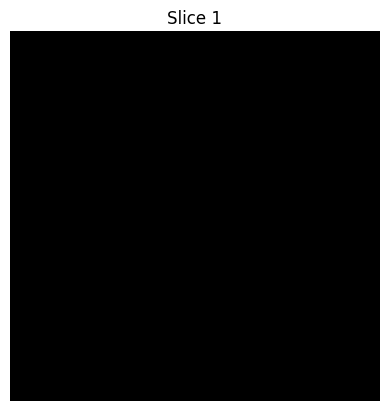

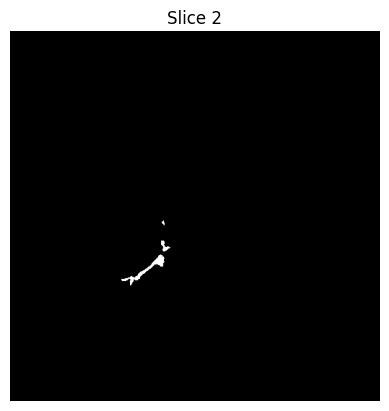

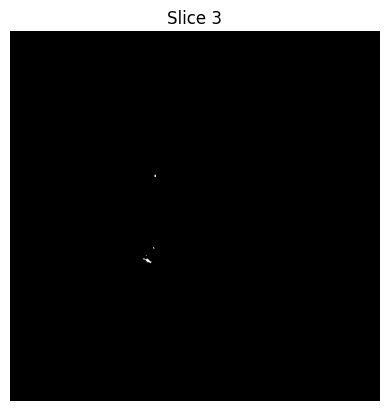

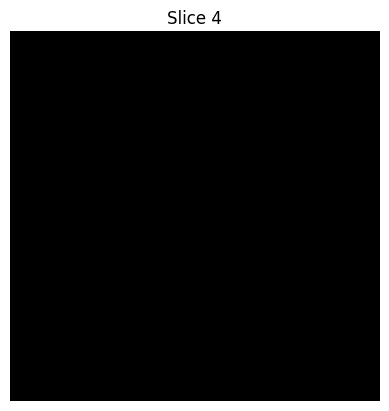

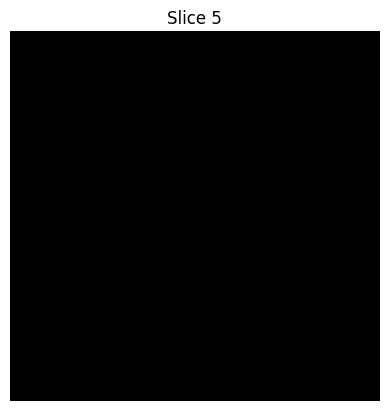

...

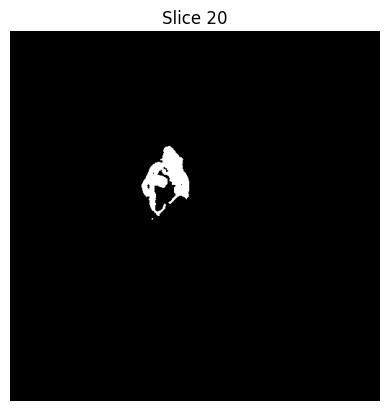

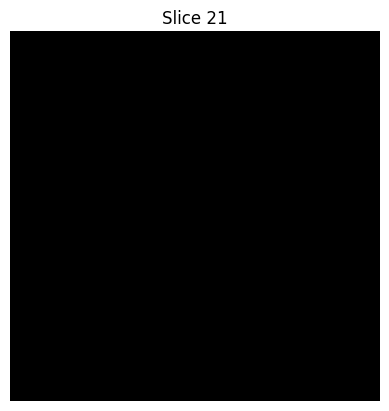

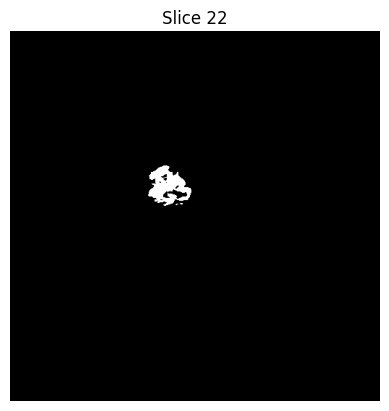

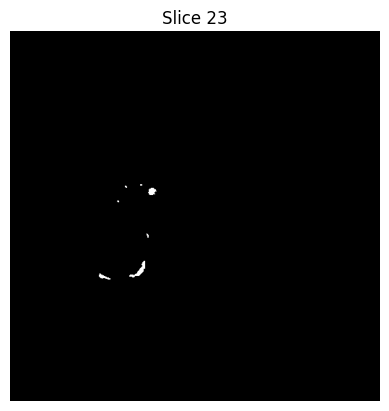

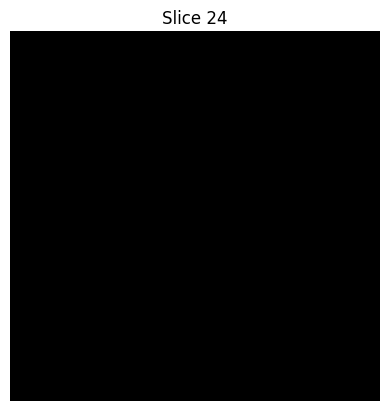

In [ ]:
import os
import pydicom
import matplotlib.pyplot as plt

scan_dir = '/Users/sercan/Documents/data_research/manifest-1542731028231/Brain-Tumor-Progression/PGBM-014/02-03-1997-NA-Mr Rcbv Sequence-24294/5370.000000-MaskTumor-08934'


dicom_files = [pydicom.dcmread(os.path.join(scan_dir, file)) for file in os.listdir(scan_dir) if file.endswith('.dcm')]

for i, dicom_file in enumerate(dicom_files[:24]):  # Display first 5 slices
    plt.imshow(dicom_file.pixel_array, cmap='gray')
    plt.title(f"Slice {i + 1}")
    plt.axis('off')
    plt.show()


In [16]:
##used chat gpt for try to reconstruct the 3D images from 2D

import pydicom
import matplotlib.pyplot as plt
import os
import numpy as np

# Define the path to the scan folder
scan_dir = '/Users/sercan/Documents/data_research/manifest-1542731028231/Brain-Tumor-Progression/PGBM-014/02-03-1997-NA-Mr Rcbv Sequence-24294/5370.000000-MaskTumor-08934'

# Load all DICOM files in the scan folder
dicom_files = [pydicom.dcmread(os.path.join(scan_dir, file)) for file in os.listdir(scan_dir) if file.endswith('.dcm')]

# Sort DICOM files by slice location (if necessary)
dicom_files.sort(key=lambda x: float(x.SliceLocation))

# Extract pixel data and stack into a 3D volume
volume_3d = np.stack([dicom_file.pixel_array for dicom_file in dicom_files], axis=-1)

# Verify the shape of the volume
print(f"Volume shape: {volume_3d.shape}")


Volume shape: (512, 512, 24)


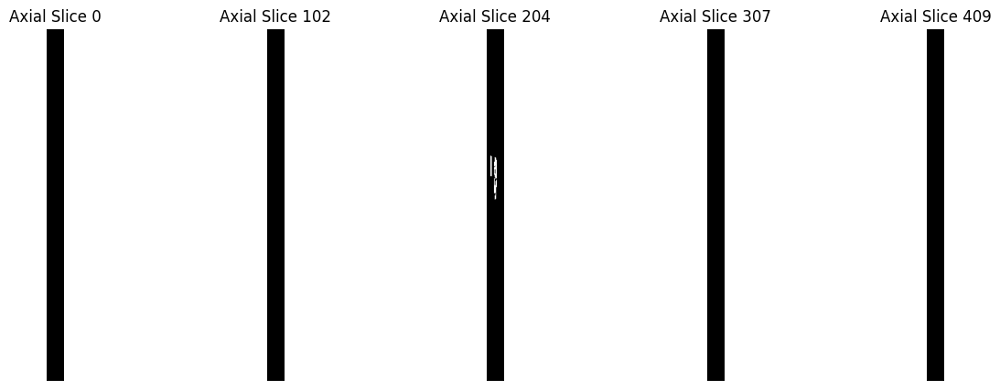

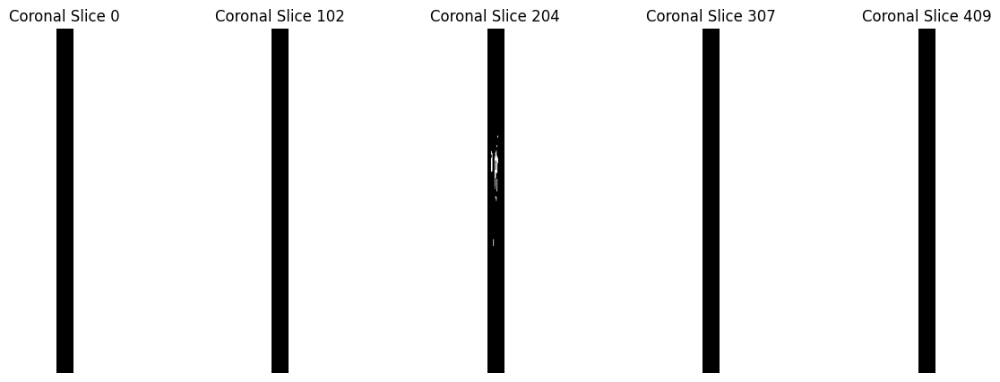

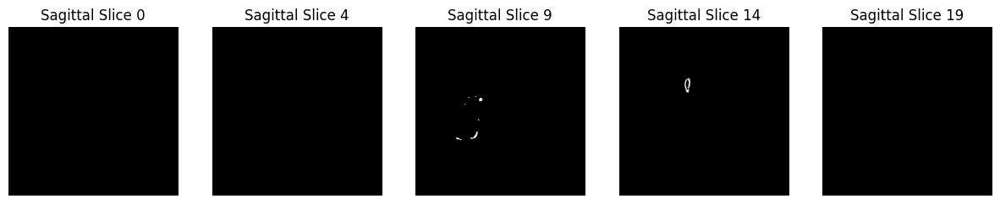

In [17]:
##used chat gpt for try to reconstruct the 3D images from 2D

# Axial view (top-down)
def show_axial_slices(volume_3d, num_slices=5):
    fig, axes = plt.subplots(1, num_slices, figsize=(15, 5))
    for i in range(num_slices):
        slice_idx = i * volume_3d.shape[0] // num_slices
        axes[i].imshow(volume_3d[slice_idx], cmap="gray")
        axes[i].set_title(f"Axial Slice {slice_idx}")
        axes[i].axis("off")
    plt.show()

# Coronal view (front view)
def show_coronal_slices(volume_3d, num_slices=5):
    fig, axes = plt.subplots(1, num_slices, figsize=(15, 5))
    for i in range(num_slices):
        slice_idx = i * volume_3d.shape[1] // num_slices
        axes[i].imshow(volume_3d[:, slice_idx, :], cmap="gray")
        axes[i].set_title(f"Coronal Slice {slice_idx}")
        axes[i].axis("off")
    plt.show()

# Sagittal view (side view)
def show_sagittal_slices(volume_3d, num_slices=5):
    fig, axes = plt.subplots(1, num_slices, figsize=(15, 5))
    for i in range(num_slices):
        slice_idx = i * volume_3d.shape[2] // num_slices
        axes[i].imshow(volume_3d[:, :, slice_idx], cmap="gray")
        axes[i].set_title(f"Sagittal Slice {slice_idx}")
        axes[i].axis("off")
    plt.show()

# Display slices in each view
show_axial_slices(volume_3d)
show_coronal_slices(volume_3d)
show_sagittal_slices(volume_3d)


In [12]:
##used chat gpt for try to reconstruct the 3D images from 2D

import plotly.graph_objects as go
import numpy as np

# Normalize intensity
volume_3d = (volume_3d - volume_3d.min()) / (volume_3d.max() - volume_3d.min())

# Set a higher threshold to reduce scattered points
threshold = np.mean(volume_3d) + 3 * np.std(volume_3d)
x, y, z = np.where(volume_3d > threshold)
values = volume_3d[volume_3d > threshold]

# Plot the refined 3D point cloud
fig = go.Figure(data=[go.Scatter3d(
    x=x, y=y, z=z,
    mode='markers',
    marker=dict(
        size=2,
        color=values,  # Use intensity for color
        colorscale='Viridis',
        opacity=0.5
    )
)])

fig.update_layout(
    scene=dict(
        xaxis_title='X',
        yaxis_title='Y',
        zaxis_title='Z'
    ),
    title="Refined 3D Point Cloud of MRI Volume",
    width=800,
    height=800
)

fig.show()


In [8]:
##used chat gpt for try to reconstruct the 3D images from 2D

from scipy.ndimage import gaussian_filter

# Apply Gaussian smoothing
volume_3d_smooth = gaussian_filter(volume_3d, sigma=1)

# Update the thresholding with smoothed volume
x, y, z = np.where(volume_3d_smooth > threshold)
values = volume_3d_smooth[volume_3d_smooth > threshold]


NameError: name 'volume_3d' is not defined

In [14]:
##used chat gpt for try to reconstruct the 3D images from 2D

# Limit to the middle 50 slices, for example
middle_slices = volume_3d[volume_3d.shape[0]//4: 3*volume_3d.shape[0]//4]
x, y, z = np.where(middle_slices > threshold)
values = middle_slices[middle_slices > threshold]


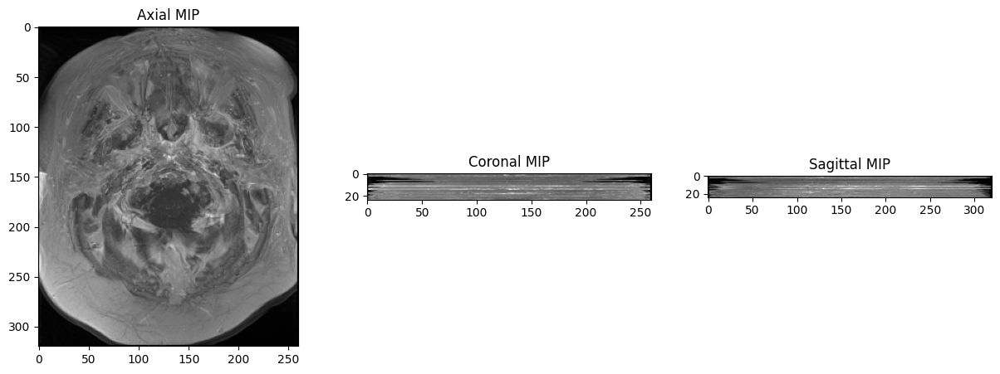

In [15]:
##used chat gpt for try to reconstruct the 3D images from 2D

# Maximum Intensity Projection along each axis
mip_axial = np.max(volume_3d, axis=0)
mip_coronal = np.max(volume_3d, axis=1)
mip_sagittal = np.max(volume_3d, axis=2)

# Plot the MIPs
fig, axes = plt.subplots(1, 3, figsize=(15, 5))
axes[0].imshow(mip_axial, cmap="gray")
axes[0].set_title("Axial MIP")
axes[1].imshow(mip_coronal, cmap="gray")
axes[1].set_title("Coronal MIP")
axes[2].imshow(mip_sagittal, cmap="gray")
axes[2].set_title("Sagittal MIP")
plt.show()


In [9]:
 print("Volume shape:", volume_3d.shape)


NameError: name 'volume_3d' is not defined

In [18]:
##used chat gpt for try to reconstruct the 3D images from 2D

from scipy.ndimage import zoom

# Define a zoom factor to increase the number of slices along the z-axis
desired_depth = 100  # Adjust as needed for smoother projections
zoom_factor = (desired_depth / volume_3d.shape[0], 1, 1)  # Only resample along z-axis

# Resample the volume
volume_3d_resampled = zoom(volume_3d, zoom_factor, order=1)  # Linear interpolation
print("Resampled volume shape:", volume_3d_resampled.shape)


Resampled volume shape: (100, 320, 260)


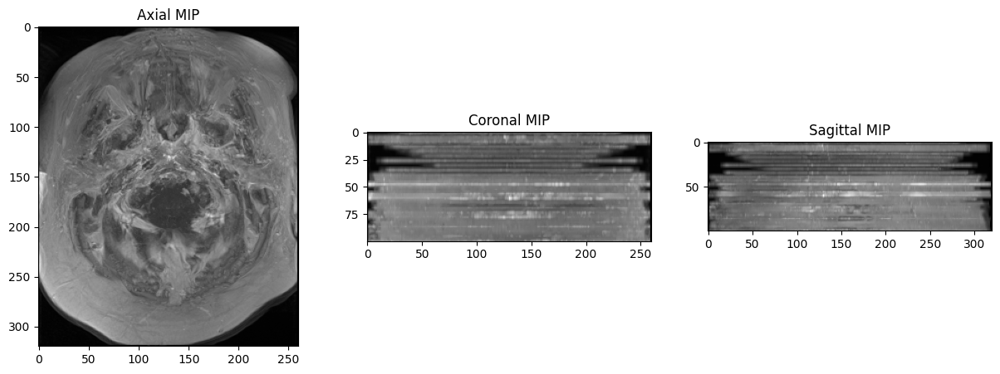

In [19]:
##used chat gpt for try to reconstruct the 3D images from 2D

# Maximum Intensity Projection along each axis
mip_axial = np.max(volume_3d_resampled, axis=0)
mip_coronal = np.max(volume_3d_resampled, axis=1)
mip_sagittal = np.max(volume_3d_resampled, axis=2)

# Plot the MIPs
fig, axes = plt.subplots(1, 3, figsize=(15, 5))
axes[0].imshow(mip_axial, cmap="gray")
axes[0].set_title("Axial MIP")
axes[1].imshow(mip_coronal, cmap="gray")
axes[1].set_title("Coronal MIP")
axes[2].imshow(mip_sagittal, cmap="gray")
axes[2].set_title("Sagittal MIP")
plt.show()


In [20]:
import plotly.graph_objects as go
import numpy as np

# Normalize intensity
volume_3d = (volume_3d - volume_3d.min()) / (volume_3d.max() - volume_3d.min())

# Set a higher threshold to reduce scattered points
threshold = np.mean(volume_3d) + 3 * np.std(volume_3d)
x, y, z = np.where(volume_3d > threshold)
values = volume_3d[volume_3d > threshold]

# Plot the refined 3D point cloud
fig = go.Figure(data=[go.Scatter3d(
    x=x, y=y, z=z,
    mode='markers',
    marker=dict(
        size=2,
        color=values,  # Use intensity for color
        colorscale='Viridis',
        opacity=0.5
    )
)])

fig.update_layout(
    scene=dict(
        xaxis_title='X',
        yaxis_title='Y',
        zaxis_title='Z'
    ),
    title="Refined 3D Point Cloud of MRI Volume",
    width=800,
    height=800
)

fig.show()


Original volume shape: (24, 320, 260)
Resampled volume shape: (100, 320, 260)


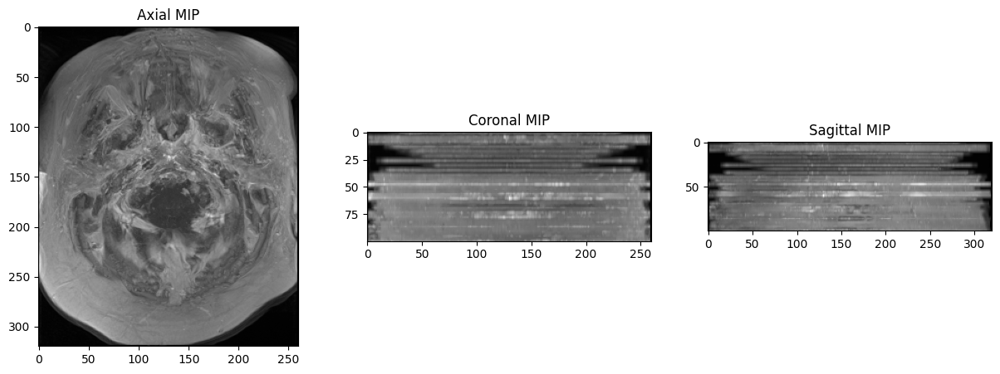

In [21]:
##used chat gpt for try to reconstruct the 3D images from 2D

import os
import pydicom
import numpy as np
import matplotlib.pyplot as plt
from scipy.ndimage import zoom, gaussian_filter
import plotly.graph_objects as go

# Step 1: Load DICOM files and stack them into a 3D volume

# Define the path to the scan folder containing DICOM files
scan_dir = '/Users/sercan/Documents/data_research/manifest-1542731028231/Brain-Tumor-Progression/PGBM-001/04-02-1992-NA-FH-HEADBrain Protocols-79896/11.000000-T1post-80644'

# Load all DICOM files in the scan folder
dicom_files = [pydicom.dcmread(os.path.join(scan_dir, file)) for file in os.listdir(scan_dir) if file.endswith('.dcm')]
volume_3d = np.stack([file.pixel_array for file in dicom_files], axis=0)
print("Original volume shape:", volume_3d.shape)

# Step 2: Resample the volume along the z-axis to increase depth

# Define desired depth (adjust this number to control the amount of resampling)
desired_depth = 100
zoom_factor = (desired_depth / volume_3d.shape[0], 1, 1)  # Only resample along the z-axis

# Resample the volume
volume_3d_resampled = zoom(volume_3d, zoom_factor, order=1)  # Linear interpolation
print("Resampled volume shape:", volume_3d_resampled.shape)

# Step 3: Compute Maximum Intensity Projections (MIPs)

# Maximum Intensity Projection along each axis
mip_axial = np.max(volume_3d_resampled, axis=0)
mip_coronal = np.max(volume_3d_resampled, axis=1)
mip_sagittal = np.max(volume_3d_resampled, axis=2)

# Plot the MIPs
fig, axes = plt.subplots(1, 3, figsize=(15, 5))
axes[0].imshow(mip_axial, cmap="gray")
axes[0].set_title("Axial MIP")
axes[1].imshow(mip_coronal, cmap="gray")
axes[1].set_title("Coronal MIP")
axes[2].imshow(mip_sagittal, cmap="gray")
axes[2].set_title("Sagittal MIP")
plt.show()

# Step 4: Smooth the volume (Optional - helps reduce noise)

# Apply Gaussian smoothing
volume_3d_smooth = gaussian_filter(volume_3d_resampled, sigma=1)

# Step 5: Create a 3D Point Cloud Visualization

# Set a threshold based on intensity (adjust this to control the level of detail in the point cloud)
threshold = np.mean(volume_3d_smooth) + 3 * np.std(volume_3d_smooth)

# Get the coordinates of the voxels above the threshold
x, y, z = np.where(volume_3d_smooth > threshold)
values = volume_3d_smooth[volume_3d_smooth > threshold]

# Plot the 3D point cloud
fig = go.Figure(data=[go.Scatter3d(
    x=x, y=y, z=z,
    mode='markers',
    marker=dict(
        size=2,
        color=values,  # Use intensity for color
        colorscale='Viridis',
        opacity=0.5
    )
)])

fig.update_layout(
    scene=dict(
        xaxis_title='X',
        yaxis_title='Y',
        zaxis_title='Z'
    ),
    title="3D Point Cloud of MRI Volume",
    width=800,
    height=800
)

fig.show()


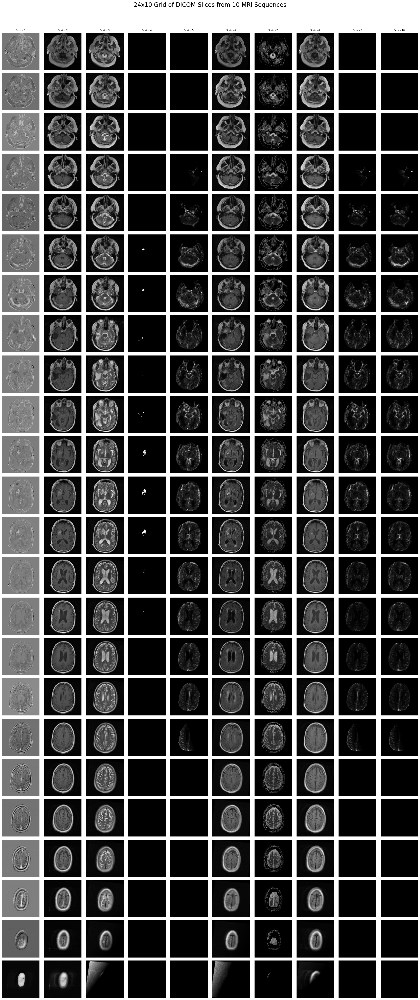

In [28]:
import os
import pydicom
import matplotlib.pyplot as plt

base_dir = '/Users/sercan/Documents/data_research/manifest-1542731028231/Brain-Tumor-Progression/PGBM-014/04-02-1997-NA-MR RCBV SEQUENCE-89894'

folders = [folder for folder in os.listdir(base_dir) if os.path.isdir(os.path.join(base_dir, folder))]

# Create a 24x10 grid
fig, axes = plt.subplots(24, 10, figsize=(20, 48))
fig.suptitle("24x10 Grid of DICOM Slices from 10 MRI Sequences", fontsize=20)

for col, folder in enumerate(folders[:10]):  
    folder_path = os.path.join(base_dir, folder)
    dicom_files = sorted([os.path.join(folder_path, file) for file in os.listdir(folder_path) if file.endswith('.dcm')])

    for row in range(24):
        dicom_file = pydicom.dcmread(dicom_files[row])
        axes[row, col].imshow(dicom_file.pixel_array, cmap='gray')
        axes[row, col].axis('off')

        if row == 0:
            axes[row, col].set_title(f"Series {col + 1}", fontsize=8)

plt.tight_layout()
plt.subplots_adjust(top=0.95)  
plt.show()


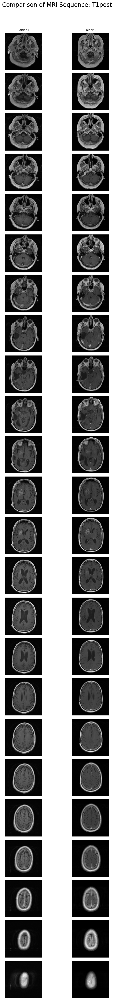

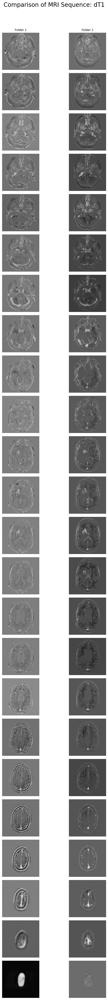

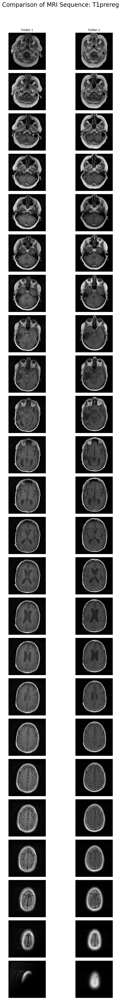

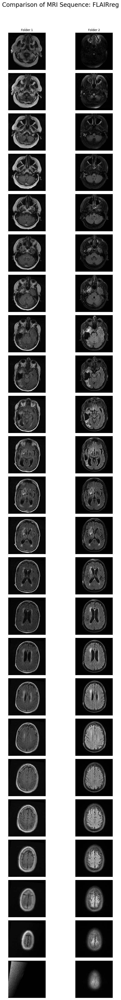

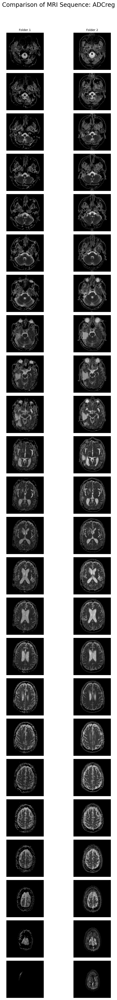

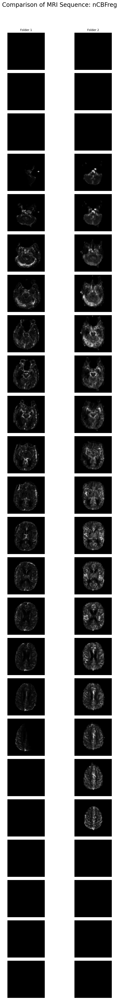

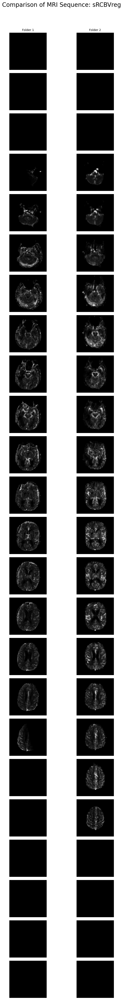

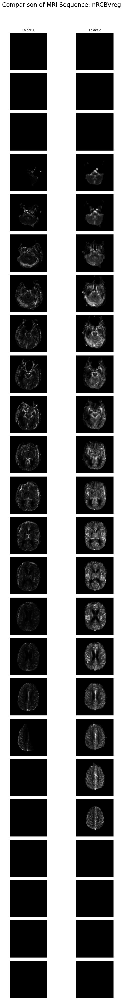

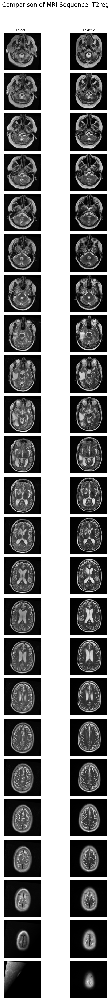

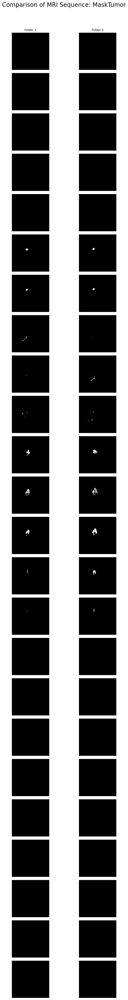

In [6]:
import os
import pydicom
import matplotlib.pyplot as plt

base_dir_2 = '/Users/sercan/Documents/data_research/manifest-1542731028231/Brain-Tumor-Progression/PGBM-014/02-03-1997-NA-Mr Rcbv Sequence-24294'
base_dir_1 = '/Users/sercan/Documents/data_research/manifest-1542731028231/Brain-Tumor-Progression/PGBM-014/04-02-1997-NA-MR RCBV SEQUENCE-89894'

output_dir = os.path.join(base_dir_1, "output")
os.makedirs(output_dir, exist_ok=True)  


folders_1 = sorted([folder for folder in os.listdir(base_dir_1) if os.path.isdir(os.path.join(base_dir_1, folder))])
folders_2 = sorted([folder for folder in os.listdir(base_dir_2) if os.path.isdir(os.path.join(base_dir_2, folder))])

def find_matching_folder(folder_name, folders):
    parts = folder_name.split('-')
    if len(parts) < 2:  
        return None
    
    for f in folders:
        if parts[1] in f: 
            return f
    return None


for folder_1 in folders_1:
    folder_2 = find_matching_folder(folder_1, folders_2)
    if folder_2 is None:
        continue  
    
    folder_1_path = os.path.join(base_dir_1, folder_1)
    folder_2_path = os.path.join(base_dir_2, folder_2)

    dicom_files_1 = sorted([os.path.join(folder_1_path, file) for file in os.listdir(folder_1_path) if file.endswith('.dcm')])[:24]
    dicom_files_2 = sorted([os.path.join(folder_2_path, file) for file in os.listdir(folder_2_path) if file.endswith('.dcm')])[:24]

    fig, axes = plt.subplots(24, 2, figsize=(8, 48))
    sequence_name = folder_1.split('-')[1]
    fig.suptitle(f"Comparison of MRI Sequence: {sequence_name}", fontsize=20)

    for row in range(24):
        dicom_file_1 = pydicom.dcmread(dicom_files_1[row])
        axes[row, 0].imshow(dicom_file_1.pixel_array, cmap='gray')
        axes[row, 0].axis('off')
        if row == 0:
            axes[row, 0].set_title("Folder 1", fontsize=10)

        dicom_file_2 = pydicom.dcmread(dicom_files_2[row])
        axes[row, 1].imshow(dicom_file_2.pixel_array, cmap='gray')
        axes[row, 1].axis('off')
        if row == 0:
            axes[row, 1].set_title("Folder 2", fontsize=10)

    plt.tight_layout()
    plt.subplots_adjust(top=0.95)  

    output_path = os.path.join(output_dir, f"Comparison_{sequence_name}.png")
    plt.savefig(output_path, bbox_inches='tight')
    plt.show()


In [ ]:
### heatmap

import os
import pydicom
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.cm as cm

base_dir_1 = '/Users/sercan/Documents/data_research/manifest-1542731028231/Brain-Tumor-Progression/PGBM-014/04-02-1997-NA-MR RCBV SEQUENCE-89894'
base_dir_2 = '/Users/sercan/Documents/data_research/manifest-1542731028231/Brain-Tumor-Progression/PGBM-014/02-03-1997-NA-Mr Rcbv Sequence-24294'

output_dir = '/Users/sercan/Documents/data_research/manifest-1542731028231/Brain-Tumor-Progression/PGBM-014/heatmap_differences'

folders_1 = sorted([folder for folder in os.listdir(base_dir_1) if os.path.isdir(os.path.join(base_dir_1, folder))])
folders_2 = sorted([folder for folder in os.listdir(base_dir_2) if os.path.isdir(os.path.join(base_dir_2, folder))])

def find_matching_folder(folder_name, folders):
    parts = folder_name.split('-')
    if len(parts) < 2:
        return None
    for f in folders:
        if parts[1] in f:
            return f
    return None


for folder_1 in folders_1:
    folder_2 = find_matching_folder(folder_1, folders_2)
    if folder_2 is None:
        continue

    folder_1_path = os.path.join(base_dir_1, folder_1)
    folder_2_path = os.path.join(base_dir_2, folder_2)
    sequence_name = folder_1.split('-')[1]

    sequence_output_dir = os.path.join(output_dir, sequence_name)
    os.makedirs(sequence_output_dir, exist_ok=True)

    dicom_files_1 = sorted([os.path.join(folder_1_path, f) for f in os.listdir(folder_1_path) if f.endswith('.dcm')])[:24]
    dicom_files_2 = sorted([os.path.join(folder_2_path, f) for f in os.listdir(folder_2_path) if f.endswith('.dcm')])[:24]

    for i, (file_1, file_2) in enumerate(zip(dicom_files_1, dicom_files_2)):
        dicom_1 = pydicom.dcmread(file_1)
        dicom_2 = pydicom.dcmread(file_2)

        img_1 = dicom_1.pixel_array.astype(np.float32)
        img_2 = dicom_2.pixel_array.astype(np.float32)
        diff = np.abs(img_1 - img_2)

        threshold = np.mean(diff) + 2 * np.std(diff)
        diff_mask = np.where(diff > threshold, diff, 0)

        diff_normalized = diff_mask / np.max(diff_mask)  # Normalize to [0, 1]
        heatmap = cm.hot(diff_normalized)[:, :, :3]  

        overlay = (0.6 * img_1[..., np.newaxis] / np.max(img_1) + 0.4 * heatmap)  # Blending
        overlay = np.clip(overlay, 0, 1)

        plt.figure(figsize=(5, 5))
        plt.imshow(overlay)
        plt.axis('off')
        plt.title(f"{sequence_name} - Slice {i+1}")
        
        output_path = os.path.join(sequence_output_dir, f"{sequence_name}_Slice_{i+1}_heatmap.png")
        plt.savefig(output_path, bbox_inches='tight', pad_inches=0)
        plt.close()

    print(f"Processed heatmap overlays for {sequence_name}")


Processed heatmap overlays for T1post
Processed heatmap overlays for dT1
Processed heatmap overlays for T1prereg
Processed heatmap overlays for FLAIRreg
Processed heatmap overlays for ADCreg


/var/folders/47/qjf7hkw90hx0cf0fgv0v_2lr0000gn/T/ipykernel_22401/2071372808.py:65: RuntimeWarning:

invalid value encountered in divide

/var/folders/47/qjf7hkw90hx0cf0fgv0v_2lr0000gn/T/ipykernel_22401/2071372808.py:69: RuntimeWarning:

invalid value encountered in divide



Processed heatmap overlays for nCBFreg
Processed heatmap overlays for sRCBVreg
Processed heatmap overlays for nRCBVreg
Processed heatmap overlays for T2reg
Processed heatmap overlays for MaskTumor


In [27]:
pip install opencv-python


Defaulting to user installation because normal site-packages is not writeable
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.5/56.5 MB 42.6 MB/s eta 0:00:00a 0:00:01
Note: you may need to restart the kernel to use updated packages.


In [32]:
### edge detection

import os
import pydicom
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.cm as cm
from scipy.ndimage import sobel

base_dir_1 = '/Users/sercan/Documents/data_research/manifest-1542731028231/Brain-Tumor-Progression/PGBM-014/04-02-1997-NA-MR RCBV SEQUENCE-89894'
base_dir_2 = '/Users/sercan/Documents/data_research/manifest-1542731028231/Brain-Tumor-Progression/PGBM-014/02-03-1997-NA-Mr Rcbv Sequence-24294'


output_dir = '/Users/sercan/Documents/data_research/manifest-1542731028231/Brain-Tumor-Progression/PGBM-014/heatmap_differences_with_edges'
os.makedirs(output_dir, exist_ok=True) 

folders_1 = sorted([folder for folder in os.listdir(base_dir_1) if os.path.isdir(os.path.join(base_dir_1, folder))])
folders_2 = sorted([folder for folder in os.listdir(base_dir_2) if os.path.isdir(os.path.join(base_dir_2, folder))])

def find_matching_folder(folder_name, folders):
    parts = folder_name.split('-')
    if len(parts) < 2:
        return None
    for f in folders:
        if parts[1] in f:
            return f
    return None


for folder_1 in folders_1:
    folder_2 = find_matching_folder(folder_1, folders_2)
    if folder_2 is None:
        continue

    folder_1_path = os.path.join(base_dir_1, folder_1)
    folder_2_path = os.path.join(base_dir_2, folder_2)
    sequence_name = folder_1.split('-')[1]

    sequence_output_dir = os.path.join(output_dir, sequence_name)
    os.makedirs(sequence_output_dir, exist_ok=True)

    dicom_files_1 = sorted([os.path.join(folder_1_path, f) for f in os.listdir(folder_1_path) if f.endswith('.dcm')])[:24]
    dicom_files_2 = sorted([os.path.join(folder_2_path, f) for f in os.listdir(folder_2_path) if f.endswith('.dcm')])[:24]

    for i, (file_1, file_2) in enumerate(zip(dicom_files_1, dicom_files_2)):
        dicom_1 = pydicom.dcmread(file_1)
        dicom_2 = pydicom.dcmread(file_2)

        img_1 = dicom_1.pixel_array.astype(np.float32)
        img_2 = dicom_2.pixel_array.astype(np.float32)
        diff = np.abs(img_1 - img_2)

        edges = sobel(diff)
        edge_mask = edges > np.mean(edges) + 2 * np.std(edges)  # Threshold edges

        diff_normalized = diff / np.max(diff)  
        heatmap = cm.hot(diff_normalized)[:, :, :3]  
        # Overlay the heatmap and edge detection on the original slice (grayscale)
        overlay = (0.5 * img_1[..., np.newaxis] / np.max(img_1) + 0.3 * heatmap + 0.2 * edge_mask[..., np.newaxis])  # Blending
        overlay = np.clip(overlay, 0, 1)

        plt.figure(figsize=(5, 5))
        plt.imshow(overlay)
        plt.axis('off')
        plt.title(f"{sequence_name} - Slice {i+1}")
        
        output_path = os.path.join(sequence_output_dir, f"{sequence_name}_Slice_{i+1}_edge_heatmap.png")
        plt.savefig(output_path, bbox_inches='tight', pad_inches=0)
        plt.close()

    print(f"Processed heatmap overlays with edges for {sequence_name}")


Processed heatmap overlays with edges for T1post
Processed heatmap overlays with edges for dT1
Processed heatmap overlays with edges for T1prereg
Processed heatmap overlays with edges for FLAIRreg
Processed heatmap overlays with edges for ADCreg


/var/folders/47/qjf7hkw90hx0cf0fgv0v_2lr0000gn/T/ipykernel_22401/1637838113.py:68: RuntimeWarning:

invalid value encountered in divide

/var/folders/47/qjf7hkw90hx0cf0fgv0v_2lr0000gn/T/ipykernel_22401/1637838113.py:72: RuntimeWarning:

invalid value encountered in divide



Processed heatmap overlays with edges for nCBFreg
Processed heatmap overlays with edges for sRCBVreg
Processed heatmap overlays with edges for nRCBVreg
Processed heatmap overlays with edges for T2reg
Processed heatmap overlays with edges for MaskTumor


In [35]:
import os
import pydicom
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.cm as cm
from scipy.ndimage import sobel

base_dir_1 = '/Users/sercan/Documents/data_research/manifest-1542731028231/Brain-Tumor-Progression/PGBM-014/04-02-1997-NA-MR RCBV SEQUENCE-89894'
base_dir_2 = '/Users/sercan/Documents/data_research/manifest-1542731028231/Brain-Tumor-Progression/PGBM-014/02-03-1997-NA-Mr Rcbv Sequence-24294'

output_dir = '/Users/sercan/Documents/data_research/manifest-1542731028231/Brain-Tumor-Progression/PGBM-014/edges_only'
os.makedirs(output_dir, exist_ok=True)  

folders_1 = sorted([folder for folder in os.listdir(base_dir_1) if os.path.isdir(os.path.join(base_dir_1, folder))])
folders_2 = sorted([folder for folder in os.listdir(base_dir_2) if os.path.isdir(os.path.join(base_dir_2, folder))])

def find_matching_folder(folder_name, folders):
    parts = folder_name.split('-')
    if len(parts) < 2:
        return None
    for f in folders:
        if parts[1] in f:
            return f
    return None

for folder_1 in folders_1:
    folder_2 = find_matching_folder(folder_1, folders_2)
    if folder_2 is None:
        continue

    folder_1_path = os.path.join(base_dir_1, folder_1)
    folder_2_path = os.path.join(base_dir_2, folder_2)
    sequence_name = folder_1.split('-')[1]

    sequence_output_dir = os.path.join(output_dir, sequence_name)
    os.makedirs(sequence_output_dir, exist_ok=True)
    dicom_files_1 = sorted([os.path.join(folder_1_path, f) for f in os.listdir(folder_1_path) if f.endswith('.dcm')])[:24]
    dicom_files_2 = sorted([os.path.join(folder_2_path, f) for f in os.listdir(folder_2_path) if f.endswith('.dcm')])[:24]

    for i, (file_1, file_2) in enumerate(zip(dicom_files_1, dicom_files_2)):
        dicom_1 = pydicom.dcmread(file_1)
        dicom_2 = pydicom.dcmread(file_2)

        # Extract pixel arrays and calculate absolute difference
        img_1 = dicom_1.pixel_array.astype(np.float32)
        img_2 = dicom_2.pixel_array.astype(np.float32)
        diff = np.abs(img_1 - img_2)

        # Edge detection using Sobel filter
        edges = sobel(diff)
        edge_only = edges > np.mean(edges) + 2 * np.std(edges)  # Threshold edges for binary mask

        # Plot and save the edge-only result
        plt.figure(figsize=(5, 5))
        plt.imshow(edge_only, cmap='gray')
        plt.axis('off')
        plt.title(f"{sequence_name} - Slice {i+1}")
        
        output_path = os.path.join(sequence_output_dir, f"{sequence_name}_Slice_{i+1}_edge_only.png")
        plt.savefig(output_path, bbox_inches='tight', pad_inches=0)
        plt.close()

    print(f"Processed edge-only images for {sequence_name}")


Processed edge-only images for T1post
Processed edge-only images for dT1
Processed edge-only images for T1prereg
Processed edge-only images for FLAIRreg
Processed edge-only images for ADCreg
Processed edge-only images for nCBFreg
Processed edge-only images for sRCBVreg
Processed edge-only images for nRCBVreg
Processed edge-only images for T2reg
Processed edge-only images for MaskTumor


In [38]:
import os
import pydicom
import numpy as np
import matplotlib.pyplot as plt

base_dir_1 = '/Users/sercan/Documents/data_research/manifest-1542731028231/Brain-Tumor-Progression/PGBM-014/04-02-1997-NA-MR RCBV SEQUENCE-89894'
base_dir_2 = '/Users/sercan/Documents/data_research/manifest-1542731028231/Brain-Tumor-Progression/PGBM-014/02-03-1997-NA-Mr Rcbv Sequence-24294'

output_dir_date1 = os.path.join(base_dir_1, 'PNG_Organized', '04-02-1997')
output_dir_date2 = os.path.join(base_dir_2, 'PNG_Organized', '02-03-1997')
os.makedirs(output_dir_date1, exist_ok=True)
os.makedirs(output_dir_date2, exist_ok=True)

def convert_dcm_to_png(dicom_files, output_dir, scan_type):
    scan_type_dir = os.path.join(output_dir, scan_type)
    os.makedirs(scan_type_dir, exist_ok=True)
    
    for i, dicom_file in enumerate(dicom_files):
        dicom_data = pydicom.dcmread(dicom_file)
        img = dicom_data.pixel_array

        slice_folder = os.path.join(scan_type_dir, f'Slice_{i + 1}')
        os.makedirs(slice_folder, exist_ok=True)
        png_path = os.path.join(slice_folder, f"{scan_type}_Slice_{i + 1}.png")
        
        plt.imsave(png_path, img, cmap="gray")
        print(f"Saved: {png_path}")

def process_date_directory(base_dir, output_dir):
    scan_type_folders = sorted([folder for folder in os.listdir(base_dir) if os.path.isdir(os.path.join(base_dir, folder))])
    
    for scan_type in scan_type_folders:

        scan_type_path = os.path.join(base_dir, scan_type)
        dicom_files = sorted([os.path.join(scan_type_path, f) for f in os.listdir(scan_type_path) if f.endswith('.dcm')])[:24]

        convert_dcm_to_png(dicom_files, output_dir, scan_type)

# Process each date directory
process_date_directory(base_dir_1, output_dir_date1)
process_date_directory(base_dir_2, output_dir_date2)

print("All DICOM files have been converted to PNG and organized by date, scan type, and slice number.")


Saved: /Users/sercan/Documents/data_research/manifest-1542731028231/Brain-Tumor-Progression/PGBM-014/04-02-1997-NA-MR RCBV SEQUENCE-89894/PNG_Organized/04-02-1997/17.000000-T1post-97818/Slice_1/17.000000-T1post-97818_Slice_1.png
Saved: /Users/sercan/Documents/data_research/manifest-1542731028231/Brain-Tumor-Progression/PGBM-014/04-02-1997-NA-MR RCBV SEQUENCE-89894/PNG_Organized/04-02-1997/17.000000-T1post-97818/Slice_2/17.000000-T1post-97818_Slice_2.png
Saved: /Users/sercan/Documents/data_research/manifest-1542731028231/Brain-Tumor-Progression/PGBM-014/04-02-1997-NA-MR RCBV SEQUENCE-89894/PNG_Organized/04-02-1997/17.000000-T1post-97818/Slice_3/17.000000-T1post-97818_Slice_3.png
Saved: /Users/sercan/Documents/data_research/manifest-1542731028231/Brain-Tumor-Progression/PGBM-014/04-02-1997-NA-MR RCBV SEQUENCE-89894/PNG_Organized/04-02-1997/17.000000-T1post-97818/Slice_4/17.000000-T1post-97818_Slice_4.png
Saved: /Users/sercan/Documents/data_research/manifest-1542731028231/Brain-Tumor-Prog

In [18]:
!pip install SimpleITK matplotlib numpy


Defaulting to user installation because normal site-packages is not writeable


In [21]:
import SimpleITK as sitk
import matplotlib.pyplot as plt
import numpy as np

dicom_series_path = '/Users/sercan/Documents/data_research/manifest-1542731028231/Brain-Tumor-Progression/PGBM-020/11-09-1989-NA-HEADBrain Protocols-61674/37906.000000-T2reg-77328'

reader = sitk.ImageSeriesReader()
series_ids = reader.GetGDCMSeriesIDs(dicom_series_path)
file_names = reader.GetGDCMSeriesFileNames(dicom_series_path, series_ids[0])
reader.SetFileNames(file_names)

image = reader.Execute()
print(f"Image Size: {image.GetSize()} (width, height, depth)")
print(f"Spacing: {image.GetSpacing()}")


Image Size: (260, 320, 24) (width, height, depth)
Spacing: (0.6875, 0.6875, 6.499999953282348)


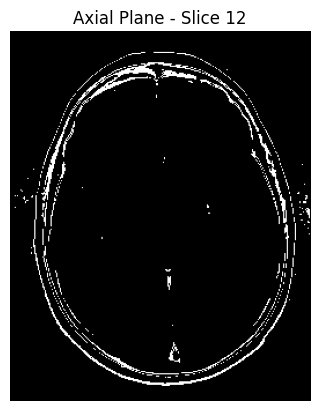

In [46]:
def threshold_volume(volume, lower_threshold, upper_threshold):
    mask = (volume >= lower_threshold) & (volume <= upper_threshold)
    return mask.astype(np.uint8)

thresholded_volume = threshold_volume(volume_3d, lower_threshold=50, upper_threshold=200)

show_slice(thresholded_volume, plane='axial', slice_index=middle_index)


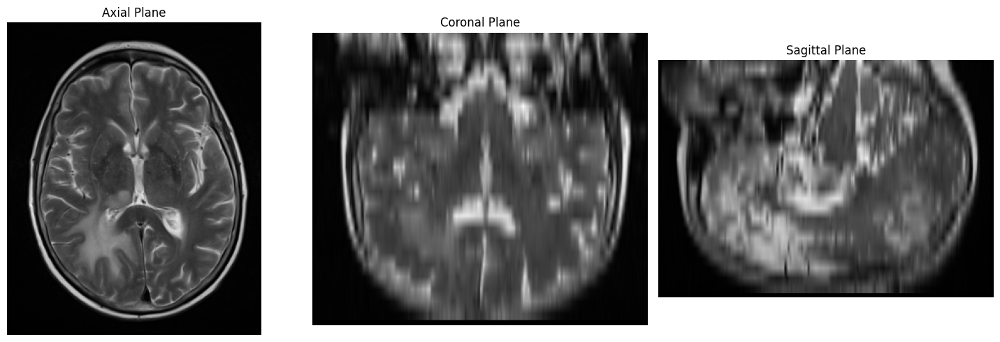

interactive(children=(Dropdown(description='plane', options=('axial', 'coronal', 'sagittal'), value='axial'), …

<function __main__.show_slice(plane='axial', slice_index=0)>

In [50]:
## Used gpt
import matplotlib.pyplot as plt
import SimpleITK as sitk
import numpy as np
from ipywidgets import interact

# Resample the image to isotropic resolution
def resample_to_isotropic(image):
    original_spacing = image.GetSpacing()
    original_size = image.GetSize()

    # Compute new size to match isotropic spacing
    min_spacing = min(original_spacing)
    new_spacing = (min_spacing, min_spacing, min_spacing)
    new_size = [
        int(round(original_size[i] * (original_spacing[i] / new_spacing[i])))
        for i in range(3)
    ]

    # Resampling filter
    resample = sitk.ResampleImageFilter()
    resample.SetOutputSpacing(new_spacing)
    resample.SetSize(new_size)
    resample.SetOutputDirection(image.GetDirection())
    resample.SetOutputOrigin(image.GetOrigin())
    resample.SetInterpolator(sitk.sitkLinear)

    return resample.Execute(image)

# Path to your DICOM directory
dicom_series_path = '/Users/sercan/Documents/data_research/manifest-1542731028231/Brain-Tumor-Progression/PGBM-020/11-09-1989-NA-HEADBrain Protocols-61674/37906.000000-T2reg-77328'

# Read the DICOM series
reader = sitk.ImageSeriesReader()
series_ids = reader.GetGDCMSeriesIDs(dicom_series_path)
file_names = reader.GetGDCMSeriesFileNames(dicom_series_path, series_ids[0])
reader.SetFileNames(file_names)

# Load and resample the 3D volume
image = reader.Execute()
isotropic_image = resample_to_isotropic(image)

# Convert resampled image to numpy array
image_array = sitk.GetArrayFromImage(isotropic_image)  # Shape: [z, y, x]

# Extract slices for MPR
axial_slice = image_array[image_array.shape[0] // 2, :, :]
coronal_slice = image_array[:, image_array.shape[1] // 2, :]
sagittal_slice = image_array[:, :, image_array.shape[2] // 2]

# Plot slices
fig, axes = plt.subplots(1, 3, figsize=(15, 5))

axes[0].imshow(axial_slice, cmap="gray")
axes[0].set_title("Axial Plane")
axes[0].axis("off")

axes[1].imshow(coronal_slice, cmap="gray")
axes[1].set_title("Coronal Plane")
axes[1].axis("off")

axes[2].imshow(sagittal_slice, cmap="gray")
axes[2].set_title("Sagittal Plane")
axes[2].axis("off")

plt.tight_layout()
plt.show()

# Interactive Slice Viewer
def show_slice(plane='axial', slice_index=0):
    plt.figure(figsize=(6, 6))
    if plane == 'axial':
        plt.imshow(image_array[slice_index, :, :], cmap='gray')
    elif plane == 'coronal':
        plt.imshow(image_array[:, slice_index, :], cmap='gray')
    elif plane == 'sagittal':
        plt.imshow(image_array[:, :, slice_index], cmap='gray')
    plt.axis('off')
    plt.title(f"{plane.capitalize()} Plane - Slice {slice_index}")
    plt.show()

interact(show_slice, plane=['axial', 'coronal', 'sagittal'], slice_index=(0, image_array.shape[0] - 1))



In [54]:
!pip install scikit-image


Defaulting to user installation because normal site-packages is not writeable
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 14.1/14.1 MB 27.7 MB/s eta 0:00:0000:010:01


In [55]:
import numpy as np
from skimage import filters, morphology

def preprocess_image(slice_data):
    # Normalize the image to [0, 1]
    slice_data = (slice_data - np.min(slice_data)) / (np.max(slice_data) - np.min(slice_data))

    # Apply Otsu's thresholding to get a binary mask
    threshold = filters.threshold_otsu(slice_data)
    binary_mask = slice_data > threshold

    # Perform morphological operations to clean noise
    binary_mask = morphology.remove_small_objects(binary_mask, min_size=100)
    binary_mask = morphology.remove_small_holes(binary_mask, area_threshold=200)
    return binary_mask


In [56]:
from scipy.ndimage import label
from skimage.measure import regionprops

def extract_largest_connected_component(binary_mask):
    # Label connected components
    labeled_mask, num_features = label(binary_mask)

    # Measure properties of the labeled regions
    regions = regionprops(labeled_mask)

    # Find the largest connected component
    largest_region = max(regions, key=lambda r: r.area)
    largest_component = labeled_mask == largest_region.label
    return largest_component


In [57]:
def segment_tumor_lcc(volume):
    segmented_volume = np.zeros_like(volume, dtype=bool)

    for i in range(volume.shape[0]):  # Iterate over slices
        slice_data = volume[i, :, :]
        binary_mask = preprocess_image(slice_data)
        largest_component = extract_largest_connected_component(binary_mask)
        segmented_volume[i, :, :] = largest_component

    return segmented_volume


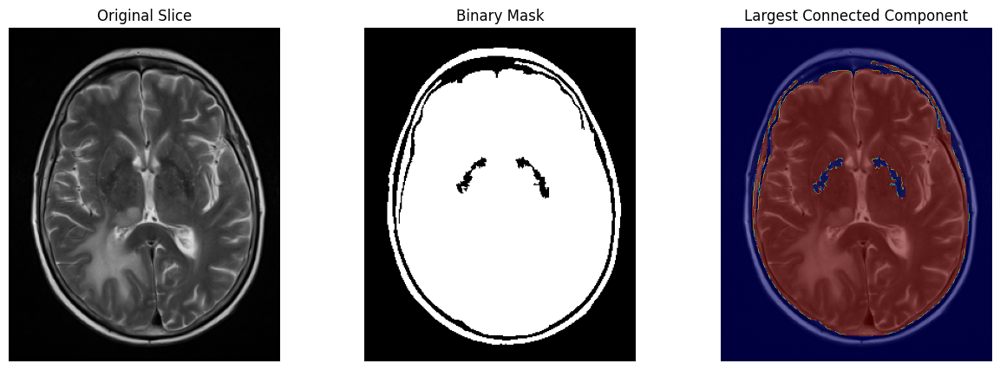

In [58]:
import matplotlib.pyplot as plt

def plot_segmentation_results(slice_data, binary_mask, largest_component):
    fig, axes = plt.subplots(1, 3, figsize=(15, 5))

    axes[0].imshow(slice_data, cmap='gray')
    axes[0].set_title('Original Slice')
    axes[0].axis('off')

    axes[1].imshow(binary_mask, cmap='gray')
    axes[1].set_title('Binary Mask')
    axes[1].axis('off')

    axes[2].imshow(slice_data, cmap='gray')
    axes[2].imshow(largest_component, cmap='jet', alpha=0.5)  # Overlay
    axes[2].set_title('Largest Connected Component')
    axes[2].axis('off')

    plt.show()

slice_index = volume_3d.shape[0] // 2
binary_mask = preprocess_image(volume_3d[slice_index, :, :])
largest_component = extract_largest_connected_component(binary_mask)
plot_segmentation_results(volume_3d[slice_index, :, :], binary_mask, largest_component)


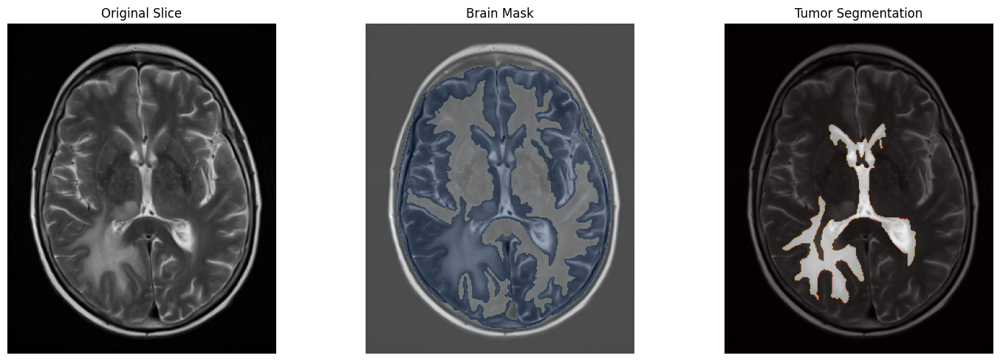

Estimated Tumor Volume: 15659.34 mm³


In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from skimage import filters, morphology, measure, exposure
import SimpleITK as sitk

class TumorSegmenter:
    def __init__(self, dicom_path):
        self.dicom_path = dicom_path
        self.image = None
        self.image_array = None
        self.load_dicom_series()
        
    def load_dicom_series(self):
        """Load DICOM series using SimpleITK"""
        reader = sitk.ImageSeriesReader()
        series_ids = reader.GetGDCMSeriesIDs(self.dicom_path)
        file_names = reader.GetGDCMSeriesFileNames(self.dicom_path, series_ids[0])
        reader.SetFileNames(file_names)
        self.image = reader.Execute()
        self.image_array = sitk.GetArrayFromImage(self.image)
        
    def preprocess_slice(self, slice_data):
        """Enhanced preprocessing for tumor segmentation"""
        normalized = exposure.rescale_intensity(slice_data, out_range=(0, 1))
        
        enhanced = exposure.equalize_adapthist(normalized)
        
        bilateral = filters.gaussian(enhanced, sigma=1, preserve_range=True)
        
        return bilateral
    
    def create_brain_mask(self, slice_data):
        """Create initial brain mask to exclude skull and background"""
        thresh = filters.threshold_otsu(slice_data)
        brain_mask = slice_data > thresh
        
        brain_mask = morphology.remove_small_objects(brain_mask, min_size=1000)
        brain_mask = morphology.remove_small_holes(brain_mask, area_threshold=1000)
        
        labeled = measure.label(brain_mask)
        props = measure.regionprops(labeled)
        if props:
            largest = max(props, key=lambda x: x.area)
            brain_mask = labeled == largest.label
            
        return brain_mask
    
    def segment_tumor(self, slice_data, brain_mask):
        """Segment tumor using multiple thresholds and refinement"""
        masked_slice = slice_data * brain_mask
        
        enhanced = exposure.equalize_adapthist(masked_slice)
        
        # Use local thresholding for tumor detection
        local_thresh = filters.threshold_local(enhanced, block_size=35)
        tumor_mask = enhanced > local_thresh
        
        # Apply morphological operations
        tumor_mask = morphology.remove_small_objects(tumor_mask, min_size=50)
        tumor_mask = morphology.remove_small_holes(tumor_mask, area_threshold=50)
        
        labeled = measure.label(tumor_mask)
        props = measure.regionprops(labeled, intensity_image=slice_data)
        
        refined_mask = np.zeros_like(tumor_mask, dtype=bool)
        for prop in props:
            if prop.mean_intensity > np.mean(slice_data[brain_mask]) + 0.5 * np.std(slice_data[brain_mask]):
                refined_mask[labeled == prop.label] = True
        
        return refined_mask
    
    def process_slice(self, slice_idx):
        """Process a single slice"""
        slice_data = self.image_array[slice_idx]
        
        preprocessed = self.preprocess_slice(slice_data)
        
        brain_mask = self.create_brain_mask(preprocessed)
        
        # Segment tumor
        tumor_mask = self.segment_tumor(preprocessed, brain_mask)
        
        return slice_data, brain_mask, tumor_mask
    
    def calculate_tumor_volume(self, tumor_mask):
        """Calculate tumor volume in mm³"""
        voxel_spacing = self.image.GetSpacing()
        voxel_volume = np.prod(voxel_spacing)
        return np.sum(tumor_mask) * voxel_volume
    
    def visualize_results(self, slice_idx):
        """Visualize segmentation results"""
        slice_data, brain_mask, tumor_mask = self.process_slice(slice_idx)
        
        fig, axes = plt.subplots(1, 3, figsize=(15, 5))
        
        # Original slice
        axes[0].imshow(slice_data, cmap="gray")
        axes[0].set_title("Original Slice")
        axes[0].axis("off")
        
        axes[1].imshow(slice_data, cmap="gray")
        axes[1].imshow(brain_mask, cmap="Blues", alpha=0.3)
        axes[1].set_title("Brain Mask")
        axes[1].axis("off")
        
        axes[2].imshow(slice_data, cmap="gray")
        axes[2].imshow(tumor_mask, cmap="hot", alpha=0.5)
        axes[2].set_title("Tumor Segmentation")
        axes[2].axis("off")
        
        plt.tight_layout()
        plt.show()
        
        volume = self.calculate_tumor_volume(tumor_mask)
        print(f"Estimated Tumor Volume: {volume:.2f} mm³")

segmenter = TumorSegmenter('/Users/sercan/Documents/data_research/manifest-1542731028231/Brain-Tumor-Progression/PGBM-020/11-09-1989-NA-HEADBrain Protocols-61674/37906.000000-T2reg-77328'
)
segmenter.visualize_results(slice_idx=segmenter.image_array.shape[0] // 2)


In [78]:
import numpy as np
import SimpleITK as sitk
from skimage import morphology, filters, measure
import matplotlib.pyplot as plt
from ipywidgets import interact
import cv2

class ModifiedWeberTumorDetector:
    def __init__(self, dicom_path):
        """Initialize the detector with DICOM path"""
        self.dicom_path = dicom_path
        self.image = None
        self.image_array = None
        self.load_dicom_series()
        
    def load_dicom_series(self):
        """Load DICOM series using SimpleITK"""
        try:
            reader = sitk.ImageSeriesReader()
            series_ids = reader.GetGDCMSeriesIDs(self.dicom_path)
            
            if not series_ids:
                raise RuntimeError("No DICOM series found in the specified directory")
                
            file_names = reader.GetGDCMSeriesFileNames(self.dicom_path, series_ids[0])
            reader.SetFileNames(file_names)
            
            self.image = reader.Execute()
            
            self.image_array = sitk.GetArrayFromImage(self.image)
            
            print(f"Loaded DICOM series with shape: {self.image_array.shape}")
            print(f"Image spacing: {self.image.GetSpacing()}")
            
        except Exception as e:
            print(f"Error loading DICOM series: {str(e)}")
            raise
    
    def morphological_transformation(self, slice_data):
        """Step 1: Morphological transformation"""
        # Normalize to 0-255
        normalized = ((slice_data - slice_data.min()) / 
                     (slice_data.max() - slice_data.min()) * 255).astype(np.uint8)
        
        kernel = cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (5,5))
        
        eroded = cv2.erode(normalized, kernel, iterations=1)
        dilated = cv2.dilate(normalized, kernel, iterations=1)
        
        return eroded, dilated
    
    def modified_weber_law(self, f, eroded_img, k):
        """Step 2: Apply modified Weber's law"""
        # Calculate Mi and mi
        Mi = np.max(eroded_img)
        mi = np.min(eroded_img)
        
        # Calculate τi (threshold)
        tau_i = (mi + Mi) / 2
        
        # Apply modified Weber's law equation
        if f <= k:
            return k * (np.log(f + 1) + Mi)
        else:
            return k * (np.log(f + 1) + mi)
    
    def calculate_k(self, mean_intensity):
        """Calculate k parameter using equation (5)"""
        return 255 - mean_intensity / np.log(256)
    
    def detect_tumor(self, slice_idx):
        """Process a single slice with all steps"""
        slice_data = self.image_array[slice_idx]
        
        eroded, dilated = self.morphological_transformation(slice_data)
        
        mean_image = (eroded + dilated) / 2
        
        k = self.calculate_k(np.mean(mean_image))
        
        processed = np.zeros_like(slice_data, dtype=float)
        for i in range(slice_data.shape[0]):
            for j in range(slice_data.shape[1]):
                processed[i,j] = self.modified_weber_law(slice_data[i,j], eroded, k)
        
        threshold = filters.threshold_otsu(processed)
        binary_mask = processed < threshold
        
        cleaned = morphology.remove_small_objects(binary_mask, min_size=100)
        cleaned = morphology.remove_small_holes(cleaned, area_threshold=100)
        
        labeled = measure.label(cleaned)
        regions = measure.regionprops(labeled)
        
        if regions:
            largest = max(regions, key=lambda x: x.area)
            tumor_mask = labeled == largest.label
            centroid = largest.centroid
        else:
            tumor_mask = np.zeros_like(binary_mask)
            centroid = None
            
        return {
            'original': slice_data,
            'eroded': eroded,
            'dilated': dilated,
            'mean': mean_image,
            'processed': processed,
            'tumor_mask': tumor_mask,
            'centroid': centroid
        }
    
    def show_interactive_results(self):
        """Display interactive results"""
        def update_display(slice_idx):
            results = self.detect_tumor(slice_idx)
            
            fig, axes = plt.subplots(2, 3, figsize=(15, 10))
            
            # Original
            axes[0,0].imshow(results['original'], cmap='gray')
            axes[0,0].set_title('Original')
            axes[0,0].axis('off')
            
            # Eroded
            axes[0,1].imshow(results['eroded'], cmap='gray')
            axes[0,1].set_title('Eroded')
            axes[0,1].axis('off')
            
            # Dilated
            axes[0,2].imshow(results['dilated'], cmap='gray')
            axes[0,2].set_title('Dilated')
            axes[0,2].axis('off')
            
            # Mean
            axes[1,0].imshow(results['mean'], cmap='gray')
            axes[1,0].set_title('Mean of Eroded and Dilated')
            axes[1,0].axis('off')
            
            # Processed
            axes[1,1].imshow(results['processed'], cmap='gray')
            axes[1,1].set_title('Weber Law Processed')
            axes[1,1].axis('off')
            
            # Tumor mask
            axes[1,2].imshow(results['original'], cmap='gray')
            mask = np.ma.masked_where(~results['tumor_mask'], np.ones_like(results['tumor_mask']))
            axes[1,2].imshow(mask, cmap='hot', alpha=0.5)
            if results['centroid'] is not None:
                axes[1,2].plot(results['centroid'][1], results['centroid'][0], 'r*', markersize=10)
            axes[1,2].set_title('Tumor Detection')
            axes[1,2].axis('off')
            
            plt.tight_layout()
            plt.show()
        
        # Create interactive slider
        interact(update_display, 
                slice_idx=(0, self.image_array.shape[0]-1))

# Example usage
dicom_path = '/Users/sercan/Documents/data_research/manifest-1542731028231/Brain-Tumor-Progression/PGBM-001/11- -1991-NA-FH-HEADBrain Protocols-40993/37910.000000-T2reg-84816'
detector = ModifiedWeberTumorDetector(dicom_path)
detector.show_interactive_results()

Loaded DICOM series with shape: (25, 320, 260)
Image spacing: (0.6875, 0.6875, 6.499999776547516)


interactive(children=(IntSlider(value=12, description='slice_idx', max=24), Output()), _dom_classes=('widget-i…